# Jingbin Cao Python and SQL Test

## TASK 1 - [DS_SAMPLE.csv]
**Using the dataset provided in DS_SAMPLE.csv:**

In [488]:
# Import Packages
import pandas as pd
import matplotlib.pyplot as plt

In [418]:
# Read DATA
data_dir = './Python-SQL/DS_SAMPLE.csv' # PATH to Data

# Read CSV Data
df = pd.read_csv(data_dir)

df.head(3)

,TYPE,WHS,PO NUMBER,STORE FLG,CITY,STATE,VENDOR NUMBER,XDOCK FLG,TEMP FLG,PALLET,...,SCHEDULE DATE,ITEM,UPC,FROM,TO,BYR,UNITS PER CASE,RANDOM WT,TRANS CODE,CREATION DATE
0,INBOUND - MASTER,197,28544,Y,CLIFTON,NJ,85579,R,D,31.82,...,10/24/2019,2010015,76069500507,,,P47,12,N,T,9/16/2019
1,PASSTHROUGH,882,30779,Y,HARTFORD,CT,32569,R,D,1.00,...,9/9/2019,430295,3120025900,,,P7E,12,N,P,8/23/2019
2,PASSTHROUGH,882,30779,Y,HARTFORD,CT,32569,R,D,0.17,...,9/9/2019,430021,3120025902,,,P7E,12,N,P,8/23/2019


### TASK 1.1. 
For each "Type" in Column A:
- A. What is the count of "PO NUMBER" by "WHS"?
- B. What is the sum of "PALLET", "TOTAL CUBE", "TOTAL CASES", "TOTAL WGHT" by "VENDOR NUMBER"?

In [422]:
# A: Count of "PO NUMBER" by "Type" and "WHS"
Answer_A = df.groupby(["TYPE", "WHS"])["PO NUMBER"].count()
# Convert to DataFrame and rename the unique counts column
Answer_A = Answer_A.reset_index(name='PO Count')

# B: Sum of "PALLET", "TOTAL CUBE", "TOTAL CASES", "TOTAL WGHT" by "Type" and "VENDOR NUMBER"
Answer_B = df.groupby(["TYPE", "VENDOR NUMBER"])[
    ["PALLET", "TOTAL CUBE", "TOTAL CASES", "TOTAL WGHT"]
].sum()
# Rename the sum columns
Answer_B = Answer_B.rename(columns={
    "PALLET": "Sum of PALLET",
    "TOTAL CUBE": "Sum of TOTAL CUBE",
    "TOTAL CASES": "Sum of TOTAL CASES",
    "TOTAL WGHT": "Sum of TOTAL WGHT"
})

In [423]:
pd.set_option('display.max_rows', None) # Show all columns if needed
Answer_A.head(3) # Remove .head(3) for displaying full rows

,TYPE,WHS,PO Count
0,INBOUND - MASTER,197,423
1,OUTBOUND,110,117
2,OUTBOUND,111,23


In [424]:
Answer_B.head(3) # Remove .head(3) for displaying full rows

Sum of PALLET  Sum of TOTAL CUBE  \
TYPE             VENDOR NUMBER                                     
INBOUND - MASTER 20120                   63.0            2756.16   
                 20547                   48.0            2431.20   
                 24269                    1.0              48.96   

                                Sum of TOTAL CASES  Sum of TOTAL WGHT  
TYPE             VENDOR NUMBER                                         
INBOUND - MASTER 20120                        3024         124334.784  
                 20547                        2400         105200.000  
                 24269                          96           2232.000

### TASK 1.2. 
Using the "SCHEDULE DATE":
- A. What is the mean of "PALLET" by day of the week?
- B. What is the average number of days between "CREATION DATE" & "SCHEDULE DATE"?
- C. Using the information calculated in B, identify rows that you consider to be "outliers". Please comment on how you decided on what is and is not an outlier.
- D. Prepare a simple time series plot showing "TOTAL WGHT" over time.
- E. For every "BYR", identify the "UPC" with the most "TOTAL CASES" ordered across time.

In [426]:
# A. Mean of "PALLET" by day of the week?

# Convert "SCHEDULE DATE" to datetime and extract day of the week
df['SCHEDULE DATE'] = pd.to_datetime(df['SCHEDULE DATE'])
df['DAY OF WEEK'] = df['SCHEDULE DATE'].dt.day_name()

# Calculate mean of "PALLET" by day of the week
Answer_A = df.groupby('DAY OF WEEK')['PALLET'].mean()
Answer_A = Answer_A.reset_index(name='Mean of PALLET')
Answer_A

,DAY OF WEEK,Mean of PALLET
0,Friday,1.157136
1,Monday,0.899677
2,Saturday,4.347059
3,Sunday,10.085455
4,Thursday,0.511245
5,Tuesday,0.853046
6,Wednesday,1.051397


In [427]:
# B. What is the average number of days between "CREATION DATE" & "SCHEDULE DATE"?

# Convert "CREATION DATE" to datetime
df['CREATION DATE'] = pd.to_datetime(df['CREATION DATE'])
df['SCHEDULE DATE'] = pd.to_datetime(df['SCHEDULE DATE'])

# Calculate the difference and take the average
df['DATE DIFF'] = (df['SCHEDULE DATE'] - df['CREATION DATE']).dt.days
Answer_B = df['DATE DIFF'].mean()


print("Average number of days between 'CREATION DATE' & 'SCHEDULE DATE':\n", Answer_B)

Average number of days between 'CREATION DATE' & 'SCHEDULE DATE':
 12.701629327902241


In [429]:
# C. Using the information calculated in B, identify rows that you consider to be "outliers". Please comment on how you decided on what is and is not an outlier.

# Calculate Q1 and Q3
Q1 = df['DATE DIFF'].quantile(0.25)
Q3 = df['DATE DIFF'].quantile(0.75)

# Calculate the Interquartile Range (IQR)
IQR = Q3 - Q1

# Define outliers as those outside of Q1 - 1.5 * IQR and Q3 + 1.5 * IQR
outliers_lower_bound = Q1 - 1.5 * IQR
outliers_upper_bound = Q3 + 1.5 * IQR

# Identify rows where 'DATE DIFF' is an outlier
Answer_C = df[(df['DATE DIFF'] < outliers_lower_bound) | (df['DATE DIFF'] > outliers_upper_bound)]

# Display these outliers
print("Outliers based on 'DATE DIFF':")
Answer_C.head(5)

Outliers based on 'DATE DIFF':


,TYPE,WHS,PO NUMBER,STORE FLG,CITY,STATE,VENDOR NUMBER,XDOCK FLG,TEMP FLG,PALLET,...,UPC,FROM,TO,BYR,UNITS PER CASE,RANDOM WT,TRANS CODE,CREATION DATE,DAY OF WEEK,DATE DIFF
0,INBOUND - MASTER,197,28544,Y,CLIFTON,NJ,85579,R,D,31.82,...,76069500507,,,P47,12,N,T,2019-09-16,Thursday,38
8,INBOUND - MASTER,197,28544,Y,CLIFTON,NJ,85579,R,D,31.82,...,76069500507,,,P47,12,N,T,2019-09-16,Tuesday,43
9,INBOUND - MASTER,197,28648,Y,CLIFTON,NJ,85579,R,D,31.82,...,76069500014,,,P47,12,N,T,2019-10-11,Friday,42
10,INBOUND - MASTER,197,28708,Y,CLIFTON,NJ,73705,R,D,22.00,...,76069555402,,,P47,2,N,T,2019-10-24,Thursday,56
11,INBOUND - MASTER,197,28533,Y,CLIFTON,NJ,86083,R,D,9.00,...,76069502654,,,P47,2,N,T,2019-09-12,Friday,50


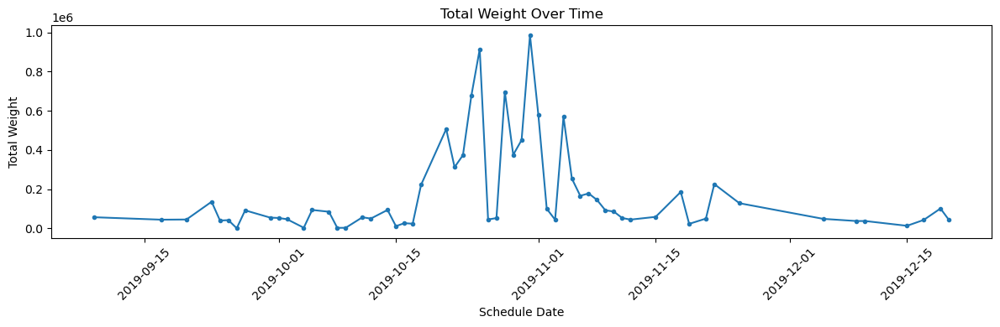

In [430]:
# D. Prepare a simple time series plot showing "TOTAL WGHT" over time

# Sort Schedule Date
df['SCHEDULE DATE'] = pd.to_datetime(df['SCHEDULE DATE'])

# Group by Schedule Date and Total Weight, adding all the total weights together by different UPCs
tmp = df[['SCHEDULE DATE','TOTAL WGHT']].groupby('SCHEDULE DATE').sum().sort_values(by="SCHEDULE DATE")

# Plot
plt.figure(figsize=(12, 4))
plt.plot(tmp, marker='.') # Sum total weight
plt.title('Total Weight Over Time')
plt.xlabel('Schedule Date')
plt.ylabel('Total Weight')
plt.xticks(rotation=45)
# plt.yscale('log')
plt.tight_layout()
plt.show()

In [10]:
# E. For every "BYR", identify the "UPC" with the most "TOTAL CASES" ordered across time

# Group by SCHEDULE DATE, BYR and UPC for each group with the summation of 'TOTAL CASES' for each of the group
df_E = df.groupby(['SCHEDULE DATE', 'BYR', 'UPC'])['TOTAL CASES'].sum().reset_index()

# Get the index of the max 'TOTAL CASES' for each 'SCHEDULE DATE' and 'BYR' group
idx_max = df_E.groupby(['SCHEDULE DATE', 'BYR'])['TOTAL CASES'].idxmax()

# Use the index to locate the rows with the maximum 'TOTAL CASES' for each 'CreationDate' and 'BYR' group
Answer_E = df_E.loc[idx_max]

Answer_E.head(10)

,SCHEDULE DATE,BYR,UPC,TOTAL CASES
0,2019-09-09,P47,76069500609,1500
2,2019-09-09,P7E,3120020097,65
7,2019-09-17,P47,76069500026,972
8,2019-09-20,P47,76069500010,1540
23,2019-09-23,P47,76069500010,1540
25,2019-09-23,P7E,76172005848,36
26,2019-09-24,P7E,76069502979,728
27,2019-09-24,P7J,4006400048,12
31,2019-09-25,P47,76069552718,1560
32,2019-09-25,P7J,4142117751,6


## TASK 2 - [Basic OOP]
**Using Python:**

### TASK 2.1. 
Design a class with two variables, checking account and savings account
- Create Functions to Deposit, Withdraw, and Transfer money between accounts
- Design it so every transaction is recorded into a dictionary with the date and time of the transaction as the key, with account(s) involved & amounts as the values

In [431]:
from datetime import datetime

class BankAccount:
    
    def __init__(self):
        self.checking_account = 0
        self.savings_account = 0
        self.transactions = {}
        
        # Count unique transactions
        self.transaction_count = 0
    
    def deposit(self, amount, account):
        if amount <= 0:
            return False  # Ensure amount is positive
        
        if account == 'checking':
            self.checking_account += amount
            
        elif account == 'savings':
            self.savings_account += amount
            
        else:
            return False  # Invalid account type
        
        self._log_transaction(account, 'deposit', amount)
        return True  # Operation Succeed
    
    
    def withdraw(self, amount, account):
        
        if amount <= 0:
            return False 
        
        if account == 'checking':
            if amount > self.checking_account:
                return False  # Insufficient funds in checking account
            
            self.checking_account -= amount # Withdraw from checking account
            
        elif account == 'savings':
            if amount > self.savings_account:
                return False  # Insufficient funds in savings account
            
            self.savings_account -= amount # Withdraw from saving accunt
            
        else:
            return False  # Invalid account type
        
        self._log_transaction(account, 'withdraw', amount)
        return True  # Operation Succeed
    
    
    def transfer(self, amount, from_account, to_account):
        
        if amount <= 0:
            return False 
        
        if from_account == 'checking' and to_account == 'savings':
            
            if amount > self.checking_account:
                return False  # Insufficient funds in checking account
            
            # Withdraw from checking
            self.checking_account -= amount
            self._log_transaction(from_account, 'withdraw', amount) 
            
            # Deposit to saving
            self.savings_account += amount
            self._log_transaction(to_account, 'deposit', amount)
            
            
        elif from_account == 'savings' and to_account == 'checking':
            
            if amount > self.savings_account:
                return False  # Insufficient funds in savings account
            
            # Withdraw from saving
            self.savings_account -= amount
            self._log_transaction(from_account, 'withdraw', amount)
            
            # Deposit to checking
            self.checking_account += amount
            self._log_transaction(to_account, 'deposit', amount)
            
            
        else:
            return False  # Invalid account types
        return True  # Operation Succeed
    
    
    def _log_transaction(self, account, transaction_type, amount):
        
        # Increment the counter for each transaction
        self.transaction_count += 1 
        
        # Record current time
        timestamp = datetime.now().strftime("%Y-%m-%d %H:%M:%S") + f"_{self.transaction_count}"
        
        
        self.transactions[timestamp] = {
            'account': account,
            'type': transaction_type,
            'amount': amount
        }

### TASK 2.2. 

Once you have done that, do the following:
- Deposit 1000 dollars in checking and 500 into savings
- Transfer 500 from checking to savings
- Deposit 250 to checking
- Withdraw 500 from savings
- Output the dictionary with all transactions

In [432]:
# Creating the BankAccount object
account = BankAccount()

# Performing transactions
account.deposit(1000, 'checking')
account.deposit(500, 'savings')
account.transfer(500, 'checking', 'savings')
account.deposit(250, 'checking')
account.withdraw(500, 'savings')

# Outputting the transaction dictionary
for timestamp, details in account.transactions.items():
    print(f"{timestamp}: {details}")

2024-03-28 22:48:56_1: {'account': 'checking', 'type': 'deposit', 'amount': 1000}
2024-03-28 22:48:56_2: {'account': 'savings', 'type': 'deposit', 'amount': 500}
2024-03-28 22:48:56_3: {'account': 'checking', 'type': 'withdraw', 'amount': 500}
2024-03-28 22:48:56_4: {'account': 'savings', 'type': 'deposit', 'amount': 500}
2024-03-28 22:48:56_5: {'account': 'checking', 'type': 'deposit', 'amount': 250}
2024-03-28 22:48:56_6: {'account': 'savings', 'type': 'withdraw', 'amount': 500}


## TASK 3 - [SQL_SAMPLE.CSV]
The sample file [SQL_SAMPLE.csv] provides a dataset that is essentially joined from multiple sources - showing item data, yearly sales/cost data, location data and daily stocklevels.

In [468]:
# Import Packages
import sqlite3
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import requests

In [469]:
# Read DATA
data_dir = './Python-SQL/SQL_SAMPLE.csv' # PATH to Data

# Read CSV Data
df = pd.read_csv(data_dir)

df.head(3)

,Branch,Item,LocationName,UPC,GroupName,RegionName,DepartmentName,YearlySales,PrimaryUPC,YearlyCost,YearlyQuantitySold,WWCSBranch,ZIP,VendorCode,Description,BuyerCode,DailyDate,DailyStocklevel
0,10,1000030,Hamilton Ave Brooklyn,5014425630,F/S FOODS,East,"Pickles, Relish F/S",0.00,76069500609,0.00,0,110,11232,71613,PEPAL,P47,6/1/2021,0
1,10,100001,Hamilton Ave Brooklyn,6172075862,GROCERY FOODS,East,OIL & SHORTENING,7050.96,6172075862,5968.24,173,110,11232,24458,MAZZ,PMI,6/1/2021,124
2,10,1000021,Hamilton Ave Brooklyn,7332410282,F/S FOODS,East,TOMATO PRODUCTS F/S,0.00,76069501449,0.00,0,110,11232,51014,TOM 3KG,P47,6/1/2021,0


### TASK 3.1. TO 3.3.

#### Create Schema
1. Insert the file into a SQLite database using Python
2. Normalize the database within SQLite using SQL - create as many tables as you think are appropriate
3. Utilize indexing on tables created in step 2

In [470]:
DATABASE_DIR = './Python-SQL/retail_data.db'

In [471]:
# Schema creation statements
sql_create_schemas = [
    """
    CREATE TABLE IF NOT EXISTS Region (
        RegionID INTEGER PRIMARY KEY AUTOINCREMENT,
        RegionName TEXT NOT NULL
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Location (
        LocationID INTEGER PRIMARY KEY AUTOINCREMENT,
        LocationName TEXT NOT NULL
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Branch (
        BranchID INTEGER PRIMARY KEY,
        LocationID INTEGER,
        ZIP TEXT NOT NULL,
        RegionID INTEGER,
        WWCSBranch INTEGER
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Department (
        DepartmentID INTEGER PRIMARY KEY AUTOINCREMENT,
        DepartmentName TEXT NOT NULL,
        GroupName TEXT NOT NULL
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Product (
        UPC INTEGER PRIMARY KEY,
        PrimaryUPC INTEGER,
        VendorCode INTEGER,
        BuyerCode TEXT
        
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Item (
        ItemID INTEGER PRIMARY KEY,
        DepartmentID INTEGER,
        PrimaryUPC INTEGER,
        Description TEXT,
        FOREIGN KEY (DepartmentID) REFERENCES Department(DepartmentID),
        FOREIGN KEY (PrimaryUPC) REFERENCES Product(PrimaryUPC)
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Sales (
        UPC INTEGER NOT NULL,
        BranchID INTEGER,
        Year INTEGER,
        YearlySales REAL,
        YearlyCost REAL,
        YearlyQuantitySold INTEGER,
        PRIMARY KEY (UPC, YEAR, BranchID),
        FOREIGN KEY (UPC) REFERENCES Product(UPC)
    );
    """,
    """
    CREATE TABLE IF NOT EXISTS Stock (
        DailyDate TEXT NOT NULL,
        DailyStockLevel INTEGER,
        BranchID INTEGER,
        UPC INTEGER NOT NULL,
        PRIMARY KEY (DailyDate, UPC),
        FOREIGN KEY (UPC) REFERENCES Product(UPC),
        FOREIGN KEY (BranchID) REFERENCES Branch(BranchID)
    );
    """
]

# Index creation statements
sql_create_indexes = [
    "CREATE INDEX IF NOT EXISTS idx_branch_id ON Branch(BranchID);",
    "CREATE INDEX IF NOT EXISTS idx_region_name ON Region(RegionName);",
    "CREATE INDEX IF NOT EXISTS idx_location_name ON Location(LocationName);",
    "CREATE INDEX IF NOT EXISTS idx_department_name ON Department(DepartmentName);",
    "CREATE INDEX IF NOT EXISTS idx_upc ON Product(UPC);",
    "CREATE INDEX IF NOT EXISTS idx_item_id ON Item(ItemID);",
    "CREATE INDEX IF NOT EXISTS idx_vendor_code ON Product(VendorCode);",
    "CREATE INDEX IF NOT EXISTS idx_buyer_code ON Product(BuyerCode);",
    "CREATE INDEX IF NOT EXISTS idx_sales_upc ON Sales(UPC);",
    "CREATE INDEX IF NOT EXISTS idx_stock_upc ON Stock(UPC);"
]

# Connect to the SQLite database
conn = sqlite3.connect(DATABASE_DIR)
c = conn.cursor()

# Execute each SQL schema creation statement
for sql_create_schema in sql_create_schemas:
    c.execute(sql_create_schema)

# Execute each SQL index creation statement
for sql_create_index in sql_create_indexes:
    c.execute(sql_create_index)

# Commit the transactions to save changes
conn.commit()

# Close the connection
conn.close()

#### Insert Data

In [472]:
conn = sqlite3.connect(DATABASE_DIR)
c = conn.cursor()

def find_or_insert(table, unique_fields, values):
    query = f"SELECT rowid FROM {table} WHERE {' AND '.join([f'{field} = ?' for field in unique_fields])}"
    c.execute(query, values)
    result = c.fetchone()
    if result:
        return result[0]
    else:
        columns = ', '.join(unique_fields)
        placeholders = ', '.join(['?'] * len(values))
        c.execute(f"INSERT INTO {table} ({columns}) VALUES ({placeholders})", values)
        conn.commit()
        return c.lastrowid

# Function to extract the year
def extract_year(date_str):
    return pd.to_datetime(date_str, errors='coerce').year

# Inserting data from DataFrame
for index, row in df.iterrows():
    region_id = find_or_insert('Region', ['RegionName'], [row['RegionName']])
    location_id = find_or_insert('Location', ['LocationName'], [row['LocationName']])
    branch_id = find_or_insert('Branch', ['BranchID', 'LocationID', 'ZIP', 'RegionID', 'WWCSBranch'], [row['Branch'], location_id, row['ZIP'], region_id, row['WWCSBranch']])
    department_id = find_or_insert('Department', ['DepartmentName', 'GroupName'], [row['DepartmentName'], row['GroupName']])
    product_id = find_or_insert('Product', ['UPC', 'PrimaryUPC', 'VendorCode', 'BuyerCode'], [row['UPC'], row['PrimaryUPC'], row['VendorCode'], row['BuyerCode']])
    item_id = find_or_insert('Item', ['ItemID', 'DepartmentID', 'PrimaryUPC', 'Description'], [row['Item'], department_id, row['PrimaryUPC'], row['Description']])
    year = extract_year(row['DailyDate'])
    find_or_insert('Sales', ['UPC', 'Year', 'YearlySales', 'YearlyCost', 'YearlyQuantitySold', 'BranchID'], [row['UPC'], year, row['YearlySales'], row['YearlyCost'], row['YearlyQuantitySold'], row['Branch']])
    find_or_insert('Stock', ['DailyDate', 'DailyStockLevel', 'BranchID', 'UPC'], [row['DailyDate'], row['DailyStocklevel'], branch_id, row['UPC']])

# Commit the transactions to save changes
conn.commit()
conn.close()

#### Check Tables in DB 

In [474]:
conn = sqlite3.connect(DATABASE_DIR)
c = conn.cursor()

# Get a list of all tables in the database
c.execute("SELECT name FROM sqlite_master WHERE type='table';")
tables = c.fetchall()

# For each table, fetch the top 10 rows and display them as a DataFrame
for table_name in tables:
    query = f"SELECT * FROM {table_name[0]} LIMIT 10;"
    df = pd.read_sql_query(query, conn)
    print(f"Table: {table_name[0]}")
    display(df)

conn.close()

Table: Region


,RegionID,RegionName
0,1,East


Table: sqlite_sequence


,name,seq
0,Region,1
1,Location,1
2,Department,4


Table: Location


,LocationID,LocationName
0,1,Hamilton Ave Brooklyn


Table: Branch


,BranchID,LocationID,ZIP,RegionID,WWCSBranch
0,10,1,11232,1,110


Table: Department


,DepartmentID,DepartmentName,GroupName
0,1,"Pickles, Relish F/S",F/S FOODS
1,2,OIL & SHORTENING,GROCERY FOODS
2,3,TOMATO PRODUCTS F/S,F/S FOODS
3,4,Olives F/S,F/S FOODS


Table: Product


,UPC,PrimaryUPC,VendorCode,BuyerCode
0,5014425630,76069500609,71613,P47
1,6172075862,6172075862,24458,PMI
2,7332410282,76069501449,51014,P47
3,70695002063,70695002109,52104,P47
4,70695002109,70695002109,52104,P47
5,75014425630,76069500609,71613,P47
6,76069500609,76069500609,71613,P47
7,76069501449,76069501449,51014,P47
8,76172006345,76172006345,24458,PMI
9,80009100148,76069501449,51014,P47


Table: Item


,ItemID,DepartmentID,PrimaryUPC,Description
0,100000,2,76172006345,MAZZ
1,100001,2,6172075862,MAZZ
2,1000012,4,70695002109,OLV 2KG
3,1000021,3,76069501449,TOM 3KG
4,1000030,1,76069500609,PEPAL


Table: Sales


,UPC,BranchID,Year,YearlySales,YearlyCost,YearlyQuantitySold
0,5014425630,10,2021,0.00,0.00,0
1,6172075862,10,2021,7050.96,5968.24,173
2,7332410282,10,2021,0.00,0.00,0
3,70695002063,10,2021,3596.66,2666.15,400
4,70695002109,10,2021,4.78,6.67,1
5,75014425630,10,2021,0.00,0.00,0
6,76069500609,10,2021,16764.71,13880.91,3758
7,76069501449,10,2021,47849.11,44332.06,8016
8,76172006345,10,2021,4951.58,4146.66,117
9,80009100148,10,2021,3.75,5.33,1


Table: Stock


,DailyDate,DailyStockLevel,BranchID,UPC
0,6/1/2021,0,10,5014425630
1,6/1/2021,124,10,6172075862
2,6/1/2021,0,10,7332410282
3,6/1/2021,-22,10,70695002063
4,6/1/2021,42,10,70695002109
5,6/1/2021,0,10,75014425630
6,6/1/2021,19,10,76069500609
7,6/1/2021,1490,10,76069501449
8,6/1/2021,7,10,76172006345
9,6/1/2021,0,10,80009100148


### TASK 3.4.  
**Using SQL syntax (please write the SQL queries within Python in a string/docstring), answer the following questions:**
- What are the top 3 selling products by Branch and Item #?
- Calculate the 3-day moving average of DailyStocklevel by Branch and UPC
- What is the lowest selling item for each group?
- What is the best selling item for each branch by department?

In [475]:
# 4.1.A. The top 3 selling products by Branch and Item #:

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    WITH RankedSales AS (
        SELECT
            S.BranchID,
            I.ItemID,
            S.UPC,
            S.YearlySales,
            S.YEAR,
            RANK() OVER (PARTITION BY S.BranchID, I.ItemID ORDER BY S.YearlySales DESC) AS SalesRank
        FROM Sales S
        JOIN Product P ON S.UPC = P.UPC
        JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
    )
    SELECT
        BranchID,
        ItemID,
        UPC,
        YearlySales,
        YEAR
    FROM RankedSales
    WHERE SalesRank <= 3
    ORDER BY BranchID, ItemID, YearlySales DESC;

    
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,BranchID,ItemID,UPC,YearlySales,YEAR
0,10,100000,76172006345,4951.58,2021
1,10,100001,6172075862,7050.96,2021
2,10,1000012,70695002063,3596.66,2021
3,10,1000012,70695002109,4.78,2021
4,10,1000021,76069501449,47849.11,2021
5,10,1000021,80009100148,3.75,2021
6,10,1000021,7332410282,0.00,2021
7,10,1000030,76069500609,16764.71,2021
8,10,1000030,5014425630,0.00,2021
9,10,1000030,75014425630,0.00,2021


In [476]:
# 4.1.B. The top 3 selling products by Branch and Item #:

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    WITH RankedSales AS (
        SELECT
            S.BranchID,
            I.ItemID,
            S.UPC,
            S.YearlyQuantitySold,
            S.YEAR,
            RANK() OVER (PARTITION BY S.BranchID, I.ItemID ORDER BY S.YearlyQuantitySold DESC) AS SalesRank
        FROM Sales S
        JOIN Product P ON S.UPC = P.UPC
        JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
    )
    SELECT
        BranchID,
        ItemID,
        UPC,
        YearlyQuantitySold,
        YEAR
    FROM RankedSales
    WHERE SalesRank <= 3
    ORDER BY BranchID, ItemID, YearlyQuantitySold DESC;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,BranchID,ItemID,UPC,YearlyQuantitySold,YEAR
0,10,100000,76172006345,117,2021
1,10,100001,6172075862,173,2021
2,10,1000012,70695002063,400,2021
3,10,1000012,70695002109,1,2021
4,10,1000021,76069501449,8016,2021
5,10,1000021,80009100148,1,2021
6,10,1000021,7332410282,0,2021
7,10,1000030,76069500609,3758,2021
8,10,1000030,5014425630,0,2021
9,10,1000030,75014425630,0,2021


In [477]:
# 4.2. The 3-day moving average of DailyStocklevel by Branch and UPC:

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    WITH RankedStock AS (
      SELECT
        DailyDate,
        DailyStockLevel,
        BranchID,
        UPC,
        DATE(DailyDate) as DateFormatted,
        AVG(DailyStockLevel) OVER (PARTITION BY BranchID, UPC 
                                   ORDER BY DATE(DailyDate) 
                                   ROWS BETWEEN 1 PRECEDING AND 1 FOLLOWING) AS MovingAvg
      FROM Stock
    )
    
    SELECT
      DailyDate,
      BranchID,
      UPC,
      MovingAvg
    FROM RankedStock
    ORDER BY BranchID, UPC, DailyDate;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result.head(5) # Remove .head(5) for full result

,DailyDate,BranchID,UPC,MovingAvg
0,6/1/2021,10,5014425630,0.0
1,6/10/2021,10,5014425630,0.0
2,6/11/2021,10,5014425630,0.0
3,6/12/2021,10,5014425630,0.0
4,6/13/2021,10,5014425630,0.0


In [478]:
# 4.3.A. The lowest selling item for each group (by quantity):

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    SELECT
        G.GroupName,
        G.UPC,
        G.ItemID,
        G.Description,
        MIN(G.YearlyQuantitySold) AS LowestYearlyQuantitySold,
        G.Year
    FROM
        (SELECT
            D.GroupName,
            I.PrimaryUPC AS UPC,
            I.ItemID,
            I.Description,
            S.YearlyQuantitySold,
            S.Year
        FROM Sales S
        JOIN Product P ON S.UPC = P.UPC
        JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
        JOIN Department D ON I.DepartmentID = D.DepartmentID) AS G
        
    GROUP BY G.GroupName, G.Year
    ;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,GroupName,UPC,ItemID,Description,LowestYearlyQuantitySold,Year
0,F/S FOODS,76069500609,1000030,PEPAL,0,2021
1,GROCERY FOODS,76172006345,100000,MAZZ,117,2021


In [479]:
# 4.3.B. The lowest selling item for each group (by profit):

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    SELECT
        G.GroupName,
        G.UPC,
        G.ItemID,
        G.Description,
        MIN(G.YearlySales) AS LowestYearlySales,
        G.Year
    FROM
        (SELECT
            D.GroupName,
            I.PrimaryUPC AS UPC,
            I.ItemID,
            I.Description,
            S.YearlySales,
            S.Year
        FROM Sales S
        JOIN Product P ON S.UPC = P.UPC
        JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
        JOIN Department D ON I.DepartmentID = D.DepartmentID) AS G
        
    GROUP BY G.GroupName, G.Year
    ;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,GroupName,UPC,ItemID,Description,LowestYearlySales,Year
0,F/S FOODS,76069500609,1000030,PEPAL,0.00,2021
1,GROCERY FOODS,76172006345,100000,MAZZ,4951.58,2021


*The lowest Yearly quantity sold items are the same as the items with lowest yearly sales. Also there is only MAZZ in Grocery Foods in database, so it is the only one we can get for year 2021*

In [480]:
# 4.4. The best selling item for each branch by department?

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    SELECT 
        S.BranchID, 
        D.DepartmentName, 
        I.ItemID,
        I.Description AS ItemDescription, 
        P.PrimaryUPC,
        S.Year,
        MAX(S.YearlySales) AS MaxYearlySales
    FROM Sales S
    JOIN Product P ON S.UPC = P.UPC
    JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
    JOIN Department D ON I.DepartmentID = D.DepartmentID
    GROUP BY S.BranchID, D.DepartmentID
    ORDER BY S.BranchID, D.DepartmentID, MaxYearlySales DESC;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,BranchID,DepartmentName,ItemID,ItemDescription,PrimaryUPC,Year,MaxYearlySales
0,10,"Pickles, Relish F/S",1000030,PEPAL,76069500609,2021,16764.71
1,10,OIL & SHORTENING,100001,MAZZ,6172075862,2021,7050.96
2,10,TOMATO PRODUCTS F/S,1000021,TOM 3KG,76069501449,2021,47849.11
3,10,Olives F/S,1000012,OLV 2KG,70695002109,2021,3596.66


In [481]:
# 4.4. The best selling item for each branch by department?

# Connect to the database
conn = sqlite3.connect(DATABASE_DIR)

sql_query = """
    SELECT 
        S.BranchID, 
        D.DepartmentName, 
        I.ItemID,
        I.Description AS ItemDescription, 
        P.PrimaryUPC,
        S.Year,
        MAX(S.YearlyQuantitySold) AS MaxYearlyQuantitySold
    FROM Sales S
    JOIN Product P ON S.UPC = P.UPC
    JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
    JOIN Department D ON I.DepartmentID = D.DepartmentID
    GROUP BY S.BranchID, D.DepartmentID
    ORDER BY S.BranchID, D.DepartmentID, MaxYearlyQuantitySold DESC;
"""

# Execute query and save to DataFrame:
df_sql_result = pd.read_sql_query(sql_query, conn)

conn.close()

df_sql_result

,BranchID,DepartmentName,ItemID,ItemDescription,PrimaryUPC,Year,MaxYearlyQuantitySold
0,10,"Pickles, Relish F/S",1000030,PEPAL,76069500609,2021,3758
1,10,OIL & SHORTENING,100001,MAZZ,6172075862,2021,173
2,10,TOMATO PRODUCTS F/S,1000021,TOM 3KG,76069501449,2021,8016
3,10,Olives F/S,1000012,OLV 2KG,70695002109,2021,400


### TASK 3.5. 

**What can you tell us about the association between Item #s, PrimaryUPCs and UPCs?**

`ItemIDs` are 1-to-1 match `PrimaryUPC`, and 1 `PrimaryUPC` might include several `UPCs` (>=1)  

Therefore, I designed the schemas to effectively manage the complexities of product inventory, branch information, and sales information. In this database design, the `Product` table serves as a central hub for detailed product information, where each unique product is identified by a `UPC`.  Other descriptive fields in this table includes name, category, brand, etc. The `UPC` acts as a key to aggregate sales and inventory data across all variations of the product, each of which has its own `UPC` in the `Sales` and `Stock` tables.

The `Item` table is directly linked to the `Product` table via the `PrimaryUPC`. This linkage ensures that each item, representing a specific product variation or package, is associated with the broader product category defined by the `PrimaryUPC`. This one-to-one relationship between `ItemID` and `PrimaryUPC` simplifies the process of mapping sales and inventory data by linking to product table.

To track sales and inventory levels, the `Sales` and `Stock` tables include `UPC` fields that reference the specific product variations. These tables also include fields for capturing transaction details, such as the number of units sold, sales revenue, costs, stock levels, and transaction dates. By joining these tables on their `UPC` fields with the `Item` and `Product` tables, detailed reports can be generated that provide insights into sales performance and inventory status for both individual product variations and aggregated product categories.

Furthermore, the inclusion of `BranchID` in the `Stock` table allows for tracking inventory levels across multiple locations, offering a granified view of product availability and facilitating efficient stock management across the business.

I also created 4 info tables for `Locations`, `Department`, `Branch`, and `Regions`, by assigning autoincrement IDs: `LocationID`, `DepartmentID`, `RegionID`, and add `BranchID` based on the original table, these 4 separated tables could be adding more information. For example, using the sample data, we can assigning `GroupName` to each `DepartmentID / DeparmentName` for adding additional information.

### TASK 3.6. More Insights

Steps:
- 1. add temprature using a 3-rd party API
- 2. plot historical temprature with stock level data in branch 10 for all UPCs 

Also draw interactive plot using plotly for more detailed information

In [492]:
import plotly.express as px
import plotly.graph_objects as go

#### Data Preperation

In [496]:
# Connect to the SQLite database
conn = sqlite3.connect(DATABASE_DIR)

query_extended = """
    SELECT S.DailyDate, S.DailyStockLevel, S.UPC, SA.YearlySales, SA.YearlyCost, 
           SA.YearlyQuantitySold, I.Description, P.PrimaryUPC
    FROM Stock S
    JOIN Sales SA ON S.UPC = SA.UPC
    JOIN Product P ON SA.UPC = P.UPC
    JOIN Item I ON P.PrimaryUPC = I.PrimaryUPC
    ORDER BY S.UPC, S.DailyDate;
"""

df_sorted_extended = pd.read_sql_query(query_extended, conn)

conn.close()

# Get Temprature Data
df_sorted_extended['DailyDate'] = pd.to_datetime(df_sorted_extended['DailyDate'])

# Unique dates for which to fetch weather data
unique_dates = df_sorted_extended['DailyDate'].dt.date.unique()

api_key = 'API_KEY'

base_url = "https://weather.visualcrossing.com/VisualCrossingWebServices/rest/services/timeline/"

weather_data = {}

# Fetch weather data for each unique date
for date in unique_dates:
    date_str = date.strftime('%Y-%m-%d')
    
    # Request URL
    url = f"{base_url}11232/{date_str}?unitGroup=us&key={api_key}&contentType=json"
    
    # Make the API request
    response = requests.get(url)
    if response.status_code == 200:
        data = response.json()
        
        # Extracting the average temperature
        temp = data['days'][0]['temp']
        
        weather_data[date] = temp
    else:
        print(f"Failed to fetch weather data for {date_str}: {response.status_code}")
        weather_data[date] = None

# Add the weather data to the DataFrame
df_sorted_extended['Temperature'] = df_sorted_extended['DailyDate'].dt.date.map(lambda x: weather_data.get(x))
df_sorted_extended.head(5)

,DailyDate,DailyStockLevel,UPC,YearlySales,YearlyCost,YearlyQuantitySold,Description,PrimaryUPC,Temperature
0,2021-06-01,0,5014425630,0.0,0.0,0,PEPAL,76069500609,66.7
1,2021-06-10,0,5014425630,0.0,0.0,0,PEPAL,76069500609,75.8
2,2021-06-11,0,5014425630,0.0,0.0,0,PEPAL,76069500609,66.6
3,2021-06-12,0,5014425630,0.0,0.0,0,PEPAL,76069500609,66.6
4,2021-06-13,0,5014425630,0.0,0.0,0,PEPAL,76069500609,67.4


#### Visualization

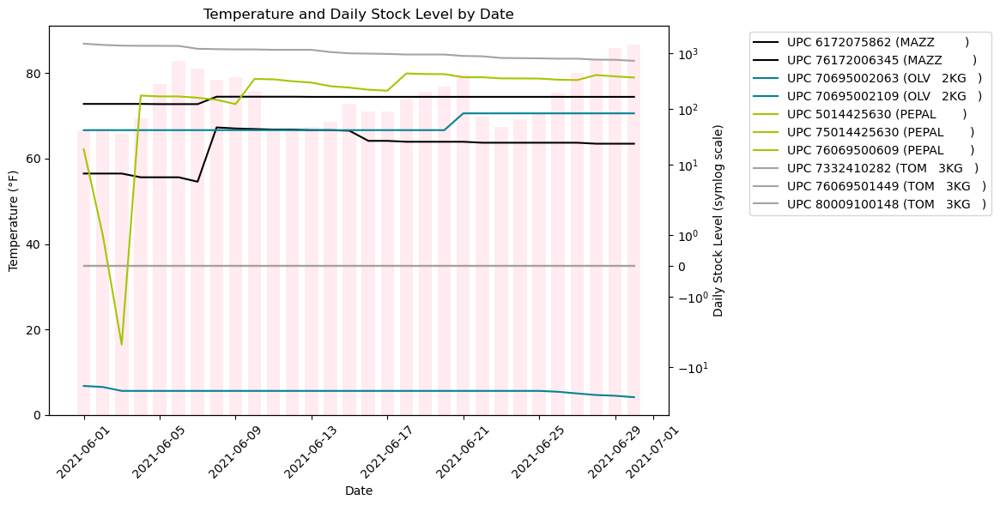

In [498]:
# Plot the table

df_sorted_extended = df_sorted_extended.sort_values(by=['Description', 'DailyDate'])

plt.figure(figsize=(12, 6))

# Create axises
ax1 = plt.gca()
ax2 = ax1.twinx()

# Plot Temperature
light_pink_color = '#FFEBF0'  # Light pink
ax1.bar(df_sorted_extended['DailyDate'], df_sorted_extended['Temperature'], color=light_pink_color, alpha=0.6, width=0.7, label='Temperature', zorder=1)

# Plotting settings for stock level
base_color_map = plt.get_cmap('nipy_spectral', len(df_sorted_extended['Description'].unique()))

# Function to adjust color brightness
def adjust_color_brightness(color, factor):
    factor = min(max(factor, 0), 1)
    return np.clip(np.array(color[:3]) * factor, 0, 1)

line_labels = []

# Plot DailyStockLevel by Description on secondary y-axis with adjusted colors
description_colors = {desc: base_color_map(i) for i, desc in enumerate(df_sorted_extended['Description'].unique())}

for desc, color in description_colors.items():
    
    for upc in df_sorted_extended[df_sorted_extended['Description'] == desc]['UPC'].unique():
        
        temp_df = df_sorted_extended[(df_sorted_extended['Description'] == desc) & (df_sorted_extended['UPC'] == upc)]
        
        lines = ax2.plot(temp_df['DailyDate'], 
                         temp_df['DailyStockLevel'], 
                         label=f'UPC {upc} ({desc})',
                         color=adjust_color_brightness(color, 0.8), zorder=2)
        
        line_labels.append(f'UPC {upc} ({desc})')  # Add label for legend

        
ax2.set_yscale('symlog')

# Set axis
ax1.set_ylabel('Temperature (°F)', color='black')
ax2.set_ylabel('Daily Stock Level (symlog scale)', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax2.tick_params(axis='y', labelcolor='black')
ax1.set_title('Temperature and Daily Stock Level by Date')
ax1.set_xlabel('Date')
ax1.tick_params(axis='x', rotation=45)


# Display legend for DailyStockLevel plots from ax2
ax2.legend(line_labels, bbox_to_anchor=(1.12, 1), loc='upper left')


plt.tight_layout()
plt.show()

#### Insights:

- For TOM 3 KG and PEPAL, even though there are 3 separate UPCs, managers tend to stock only one from them (similar color representing the same description item only see 1 line), except for MAZZ because the branch stores both.  

- Besides, there are also negative values for `PEPAL` and `OLV 2KG`, might need better data or information from the business.  

- Temprature (light pink bars) might not related to stock level across times.  

- TOM 3KG is the most demanding item.

#### Interactive Visualization

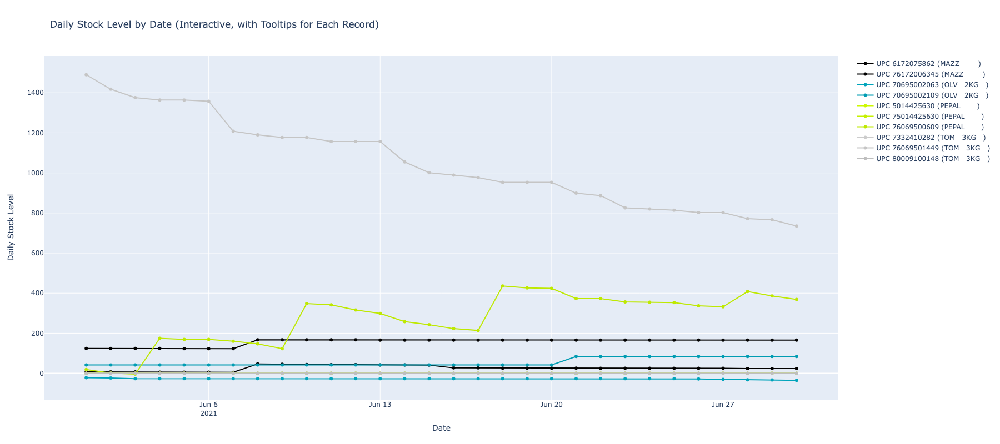

In [499]:
fig = go.Figure()

for desc, color in description_colors.items():
    
    df_desc = df_sorted_extended[df_sorted_extended['Description'] == desc]
    unique_upcs_desc = df_desc['UPC'].unique()

    for i, upc in enumerate(unique_upcs_desc):
        
        temp_df = df_desc[df_desc['UPC'] == upc]
        factor = 1 - 0.1 * i / len(unique_upcs_desc)
        adjusted_color = adjust_color_brightness(color, factor)

        fig.add_trace(go.Scatter(x=temp_df['DailyDate'], y=temp_df['DailyStockLevel'],
                                 mode='lines+markers',
                                 name=f'UPC {upc} ({desc})', # Add desc for each UPC
                                 line=dict(color='rgba' + str((*adjusted_color, 1))),
                                 hoverinfo='text',
                                 text=temp_df.apply(lambda row: f'UPC: {row["UPC"]}, Date: {row["DailyDate"].strftime("%Y-%m-%d")}, Stock Level: {row["DailyStockLevel"]}', axis=1)))

fig.update_layout(title='Daily Stock Level by Date (Interactive, with Tooltips for Each Record)',
                  xaxis_title='Date',
                  yaxis_title='Daily Stock Level',
                  hovermode='closest',
                  height=800, 
                  width=1000) 

fig.show()

# Jingbin Cao Data Science Test

- Gives information on possible incremental sales to customers by departments that we have identified. Each row is a unique customer while each column represents a category of products.
- The values contained are the dollar amount potential incremental sales for a customer/category combination.

In [503]:
# Import packages
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

In [501]:
# PATH to Data
data_dir = './DS/customer_data.xlsx'

# Read the Excel file
df = pd.read_excel(data_dir, index_col='CustomerID')

In [504]:
# Check if there is any 0 values in the table:
(df==0).sum().sum()

0

<span style="background-color: #FFFF00">***Note**: Since there is no $0.0 in the table, I can assume non values are actually 0 dollar, and comfortable to fill NaN with 0, without impact on the histgram plot for data visualization.*</span>

In [505]:
# Clean Data: fill NaN with 0
df = df.fillna(0)
df.to_csv("./DS/clean_customer_data.csv")

### Data Quality Check

In [507]:
# Read data
df = pd.read_csv("./DS/clean_customer_data.csv", index_col=0)

### Generate Attributes / Features

**Description for each attribute:**

1. **Total Spend**: The total dollar value of potential incremental sales for each customer across all departments.
2. **Mean Spend**: The average dollar value of potential incremental sales per department for each customer.
3. **Variance**: The measure of spread that shows how much the potential incremental sales amounts vary from the average spend.
4. **Std Dev**: The standard deviation of the potential incremental sales.

5. **Min Spend**: The smallest dollar value of potential incremental sales among all departments for each customer (all 0 in this case).
6. **Quartile 1 Department Spend**: The 25th percentile spend across departments for each customer.
7. **Median Department Spend**: The median spend across departments for each customer.
8. **Quartile 3 Department Spend**: The 75th percentile spend across departments for each customer.
9. **Highest Department Spend**: The maximum spend in any single department for each customer.
10. **Sum of Top 5 Departments**: The total spend in the five departments with the highest potential incremental sales for each customer.

11. **Percentage in Top 1 Department**: The percentage of total potential incremental sales that comes from the department with the highest spend.
12. **Percentage in Top 5 Departments**: The percentage of total potential incremental sales accounted for by the top five departments with the highest spends.

13. **Departments Spent Number**: The number of departments per customer with potential for incremental sales (spend greater than 0).  
14. **Departments Not Spent Number**: The number of departments per customer with no potential for incremental sales (spend equals 0).

15. **Average Spend in Non-Zero Departments**: The average spend across departments with potential for incremental sales (excluding departments with $0 spend).
16. **Less Than Mean Spend Departments Number**: The number of departments per customer where the spend is less than the average spend across all departments.
17. **More Than Mean Spend Departments**: The number of departments per customer where the spend is greater than the average spend.

18. **Low vs High Spend Ratio**: The ratio comparing the number of departments with spends below the mean to those above the mean, with adjustments to avoid division by zero.
19. **Sum of Squares of Spends**: The sum of the squared dollar values of potential incremental sales across all departments for each customer.

20. **Peak Spend Ratio**: The ratio of the highest departmental spend to the total spend for each customer.
21. **Spend Variability**: The ratio of the standard deviation to the mean spend across departments.
22. **Unique Spend Amounts**: The number of unique spend amounts across all departments for each customer.

In [508]:
# Calculate the descriptive statistics:

# Mean spend per department for each customer:
mean_spend_per_customer = df.mean(axis=1) 

# Count of departments with spend less than the customer's mean spend:
low_spend_departments = df.lt(mean_spend_per_customer, axis=0).sum(axis=1)  

# Count of departments with spend greater than the customer's mean spend:
high_spend_departments = df.gt(mean_spend_per_customer, axis=0).sum(axis=1)

# Sum the spend for top 5 departments
top_5_dept_spend = df.apply(lambda x: x.nlargest(5).sum(), axis=1)

descriptive_stats = {
    
    'Total Spend': df.sum(axis=1),
    'Mean Spend': df.mean(axis=1),
    'Variance': df.var(axis=1),
    'Std Dev': df.std(axis=1),
    
    'Min Spend': df.min(axis=1),
    'Quartile 1 Department Spend': df.quantile(0.25, axis=1),    
    'Median Department Spend': df.median(axis=1),
    'Quartile 3 Department Spend': df.quantile(0.75, axis=1),
    'Highest Department Spend': df.max(axis=1),
    'Sum of Top 5 Departments': df.apply(lambda x: x.nlargest(5).sum(), axis=1),
    
    'Percentage in Top 1 Department': 100 * df.max(axis=1) / df.sum(axis=1),
    'Percentage in Top 5 Departments': 100 * top_5_dept_spend / df.sum(axis=1),
    
    'Departments Spent Number': df.gt(0).sum(axis=1),
    'Departments Not Spent Number': df.eq(0).sum(axis=1),
    'Average Spend in Non-Zero Departments': df[df > 0].mean(axis=1),

    # 'Skewness': df.skew(axis=1),
    # 'Kurtosis': df.kurtosis(axis=1),

    'Less Than Mean Spend Departments Number': low_spend_departments,
    'More Than Mean Spend Departments': high_spend_departments,
    'Low vs High Spend Ratio': low_spend_departments / high_spend_departments.replace(0, np.nan),
    
    
    'Sum of Squares of Spends': df.apply(lambda x: np.sum(x**2), axis=1),

    'Peak Spend Ratio': df.max(axis=1) / df.sum(axis=1),
    'Spend Variability': df.std(axis=1) / df.mean(axis=1),
    
    'Unique Spend Amounts': df.nunique(axis=1)
}

# Create the df_desc dataframe.
df_desc = pd.DataFrame(descriptive_stats)
df_desc.to_csv('./DS/desc_customer_data.csv')

In [509]:
df_desc.head(3)

,Total Spend,Mean Spend,Variance,Std Dev,Min Spend,Quartile 1 Department Spend,Median Department Spend,Quartile 3 Department Spend,Highest Department Spend,Sum of Top 5 Departments,...,Departments Spent Number,Departments Not Spent Number,Average Spend in Non-Zero Departments,Less Than Mean Spend Departments Number,More Than Mean Spend Departments,Low vs High Spend Ratio,Sum of Squares of Spends,Peak Spend Ratio,Spend Variability,Unique Spend Amounts
CustomerID,,,,,,,,,,,,,,,,,,,,,
Customer 1,5539.82,17.928220,4627.069728,68.022568,0.0,0.00,1.12,8.35,771.95,2213.79,...,231,78,23.981905,264,45,5.866667,1.524457e+06,0.139346,3.794162,193
Customer 2,4237.29,13.712913,1077.518890,32.825583,0.0,0.05,1.71,10.82,263.71,1017.89,...,255,54,16.616824,242,67,3.611940,3.899814e+05,0.062236,2.393772,213
Customer 3,4622.20,14.958576,1739.174469,41.703411,0.0,0.07,2.06,9.48,419.02,1337.72,...,255,54,18.126275,254,55,4.618182,6.048073e+05,0.090654,2.787927,216


#### Plot Descriptive Stats for Each Feature
This section will check the distributions of all the computed features

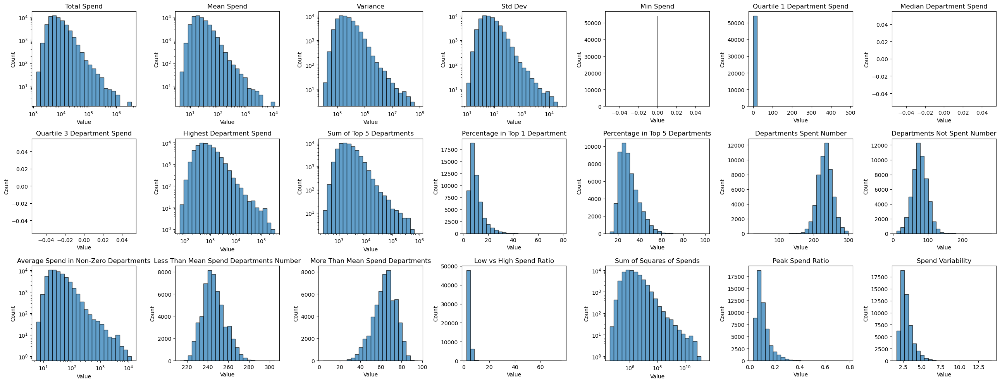

In [510]:
# Function to determine if logarithmic scale is needed
def should_use_log_scale(data):
    range_span = data.max() - data.min()
    return range_span > 1e3 and data.min() > 0

# Function to adjust bins based on the data range
def adjust_bins(data):
    range_span = data.max() - data.min()
    if range_span > 1e3:
        return np.logspace(np.log10(data.min()), np.log10(data.max()), 25)
    else:
        return np.linspace(data.min(), data.max(), 25)

# Plotting
fig, axes = plt.subplots(nrows=3, ncols=7, figsize=(26, 10))
axes = axes.flatten()

for ax, column in zip(axes, df_desc.columns):
    data = df_desc[column]
    bins = adjust_bins(data)
    
    if should_use_log_scale(data):
        ax.hist(data, bins=bins, edgecolor='k', alpha=0.7, log=True)
        ax.set_xscale('log')
    else:
        ax.hist(data, bins=bins, edgecolor='k', alpha=0.7)

    ax.set_title(column)
    ax.set_ylabel('Count')
    ax.set_xlabel('Value')

plt.tight_layout()
plt.show()

Text(0.5, 0, 'Quartile 3 Spend')

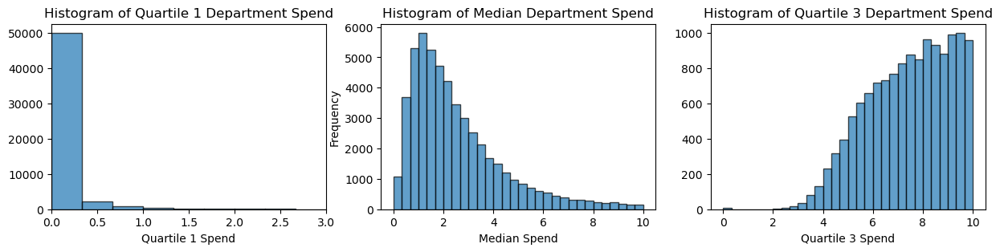

In [511]:
# Plotting the histograms for 'Median Spend', 'Quartile 1 Spend', and 'Quartile 3 Spend'
plt.figure(figsize=(15, 3))

# Histogram for 'Quartile 1 Spend'
plt.subplot(1, 3, 1)
plt.hist(df_desc['Quartile 1 Department Spend'], bins=30, range=(0, 10), edgecolor='k', alpha=0.7)
plt.title('Histogram of Quartile 1 Department Spend')
plt.xlabel('Quartile 1 Spend')
# plt.xscale('log')
plt.xlim(0, 3)

# Histogram for 'Median Spend'
plt.subplot(1, 3, 2)
plt.hist(df_desc['Median Department Spend'], bins=30, range=(0, 10), edgecolor='k', alpha=0.7)
plt.title('Histogram of Median Department Spend')
plt.xlabel('Median Spend')
plt.ylabel('Frequency')

# Histogram for 'Quartile 3 Spend'
plt.subplot(1, 3, 3)
plt.hist(df_desc['Quartile 3 Department Spend'], bins=30, range=(0, 10), edgecolor='k', alpha=0.7)
plt.title('Histogram of Quartile 3 Department Spend')
plt.xlabel('Quartile 3 Spend')

<span style="background-color: #FFFF00">**Insights:**</span>  

From the histogram, we can see many similar distributions for some features/attributes calculated, such as Spend attributes *(Total, Mean, Variance, Std. Dev, Sum of Squares, etc.)* and Top Department Spend attributes *(Top 1, Top 5, etc.)*, suggesting that the potential incremental sales data across different departments exhibit uniformity, indicating that customers' spending behaviors across various departments might follow similar patterns or trends.  

In the subsequent parts of this project, I will group customers based on the features and business insights, aiming to identify potential sales opportunities by understanding the clusters of customer behaviors and tailoring strategies to target them effectively.

## Q1. Customer Segmentation

In this section, I would choose the attributes and define thresholds for the attributes to define different groups of customers.

### Step 1. Choose Attributes

#### 1. Total Spend

From the histogram, we can see similar distributions between **total spent**, **quartile 1, 2, and 3 spent**, **top 1 and top 5 department spent** in customer level, therefore, we can choose `total spend` as the primary criteria for grouping the customers. Also the correlation matrix shows a similar patterns between those related variables.

In [514]:
# Find 0 spend customers
print(len(df_desc[df_desc['Total Spend'] == 0]))

0


<span style="background-color: #ADD8E6">*Note: Since every customer contributes to the profit, all the customers have possible incremental sales opportunities and the data is not biased.*</span>

In [515]:
# Correlation between each attributes and Total Spend
df_desc.corr().iloc[:, 0] # 0 column is the Total Spend

Total Spend                                1.000000
Mean Spend                                 1.000000
Variance                                   0.801201
Std Dev                                    0.908276
Min Spend                                       NaN
Quartile 1 Department Spend                0.834961
Median Department Spend                    0.883668
Quartile 3 Department Spend                0.942041
Highest Department Spend                   0.815567
Sum of Top 5 Departments                   0.907048
Percentage in Top 1 Department             0.022089
Percentage in Top 5 Departments            0.024783
Departments Spent Number                  -0.039716
Departments Not Spent Number               0.039716
Average Spend in Non-Zero Departments      0.858774
Less Than Mean Spend Departments Number    0.012434
More Than Mean Spend Departments          -0.012434
Low vs High Spend Ratio                    0.041396
Sum of Squares of Spends                   0.810992
Peak Spend R

#### 2. Percentage in Top 5 Departments

<span style="background-color: #ADD8E6">*Note: Since **Top 1 / Top 5 Amount Spend** are highly correlated to **Total Spend**, we used **Percentage in Top 5 Departments** for the attributes.*</span>  
From the correlation matrix below, we can find that `Percentage in Top 5 Departments` has very low correlation between Spending attributes.

In [516]:
# Correlation between each attributes and Percentage in Top 5 Departments
df_desc.corr().iloc[:, 11] # column 11 is Percentage in Top 5 Departments

Total Spend                                0.024783
Mean Spend                                 0.024783
Variance                                   0.032480
Std Dev                                    0.146796
Min Spend                                       NaN
Quartile 1 Department Spend               -0.033693
Median Department Spend                   -0.063837
Quartile 3 Department Spend               -0.067749
Highest Department Spend                   0.195693
Sum of Top 5 Departments                   0.149428
Percentage in Top 1 Department             0.874755
Percentage in Top 5 Departments            1.000000
Departments Spent Number                  -0.310243
Departments Not Spent Number               0.310243
Average Spend in Non-Zero Departments      0.070511
Less Than Mean Spend Departments Number    0.877287
More Than Mean Spend Departments          -0.877287
Low vs High Spend Ratio                    0.838243
Sum of Squares of Spends                   0.028313
Peak Spend R

#### 3. Departments Spent Number

`Departments Spent Number` is another good attributes to separate customers. From the correlation chart below, we can find that it has relatively low correlations between other attributes

In [517]:
# Correlation between each attributes and Departments Spent Number
df_desc.corr().iloc[:, 12] # column 12 is Departments Spent Number

Total Spend                               -0.039716
Mean Spend                                -0.039716
Variance                                  -0.024757
Std Dev                                   -0.111833
Min Spend                                       NaN
Quartile 1 Department Spend                0.097761
Median Department Spend                    0.114860
Quartile 3 Department Spend                0.045857
Highest Department Spend                  -0.122021
Sum of Top 5 Departments                  -0.110798
Percentage in Top 1 Department            -0.228543
Percentage in Top 5 Departments           -0.310243
Departments Spent Number                   1.000000
Departments Not Spent Number              -1.000000
Average Spend in Non-Zero Departments     -0.133284
Less Than Mean Spend Departments Number   -0.360385
More Than Mean Spend Departments           0.360385
Low vs High Spend Ratio                   -0.318630
Sum of Squares of Spends                  -0.019718
Peak Spend R

### Step 2. Choose Threshold

In the below part, I will make thresholds for each group of customers.  
Please note that for reproductivity purpose, I will use **percentile** to make the threshold rather than using hard coded values.

In [524]:
import plotly.express as px

# Define a function to draw scatter plots with options for log scale on x and y axes
def plot_scatter(df, x_col_num, y_col_nums, height=350, log_x=False, log_y=False):
    """
    Draws scatter plots for specified columns with options for log scales.

    Parameters:
    - df: DataFrame containing the data.
    - x_col_num: Column number for the x-axis.
    - y_col_nums: List of column numbers for the y-axis.
    - log_x: Boolean, set True to use log scale on the x-axis.
    - log_y: Boolean, set True to use log scale on the y-axis.
    """

    x_column_name = df.columns[x_col_num]
    y_column_names = [df.columns[num] for num in y_col_nums]

    
    # Draw plots for each y
    for y_col_num, y_column_name in zip(y_col_nums, y_column_names):
        fig = px.scatter(
            x=df.iloc[:, x_col_num],
            y=df.iloc[:, y_col_num],
            log_x=log_x,  # Set log scale for X axis based on input
            log_y=log_y,  # Set log scale for Y axis based on input
            labels={'x': x_column_name, 'y': y_column_name}
        )
        fig.update_layout(
            title=f'Scatter Plot: {x_column_name} vs {y_column_name}',
            xaxis_title=x_column_name,
            yaxis_title=y_column_name,
            height=350 # adjustable
        )
        fig.show()

#### 1. Total Spend

In [520]:
# Total Spend
df_desc.describe(percentiles=[0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.92, 0.95, 0.98]).round(2).iloc[:, 0]

count      54103.00
mean       10144.89
std        27106.31
min         1303.89
5%          3045.60
10%         3481.62
25%         4507.94
50%         6614.73
75%        10821.89
90%        17647.26
92%        19597.45
95%        24416.82
98%        37014.24
max      3473273.44
Name: Total Spend, dtype: float64

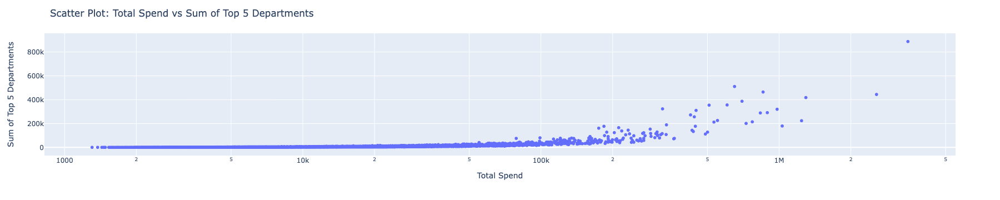

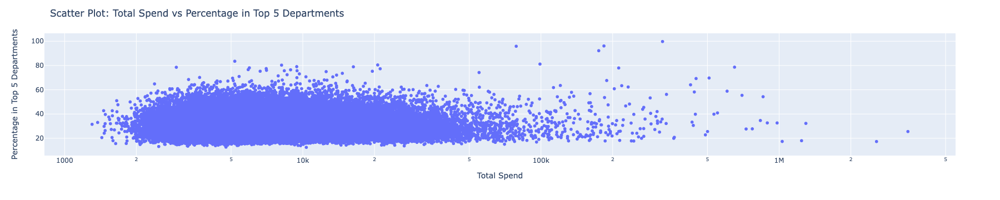

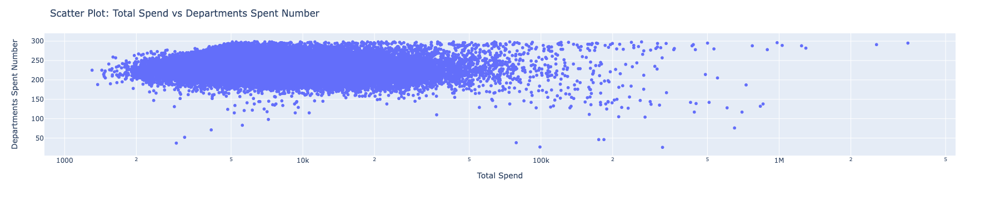

In [526]:
# Draw Scatter plots between Total Spend and Other Two Attributes
plot_scatter(df_desc, 0, [9, 11, 12], log_x=True, log_y=False, height = 350)

<span style="background-color: #ADD8E6">*Note: The scatter plot proves the high correlation between **top 5 department spend** and **all department spend**, so we do not need to use total spend of 5 deparments as the attribute.*</span>


I divide customers into **3 Groups**  

Thresholds:  
10%        `$3481.62`    
92%        `$19597.45`  

#### 2. Percentage in Top 5 Departments

In [527]:
# Percentage in Top 5 Departments
df_desc.describe(percentiles=[0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95]).round(2).iloc[:, 11]

count    54103.00
mean        30.11
std          8.63
min         12.51
1%          17.20
5%          19.25
10%         20.64
25%         23.58
50%         28.38
75%         35.00
90%         42.34
95%         46.80
max         99.76
Name: Percentage in Top 5 Departments, dtype: float64

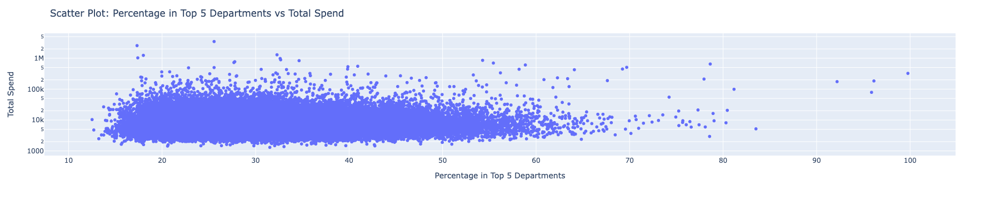

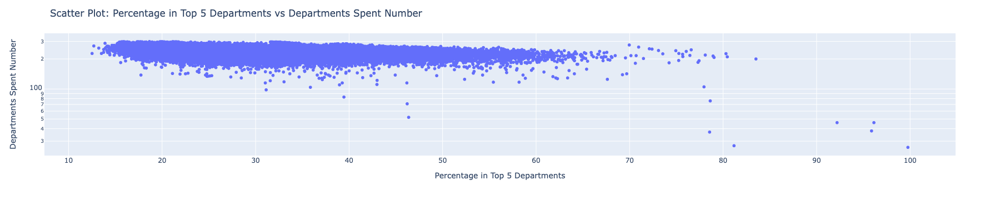

In [528]:
# Draw Scatter plots between Total Spend and Other Two Attributes
plot_scatter(df_desc, 11, [0, 12], log_x=False, log_y=True, height = 300)

I divide customers into **2 groups**  

Threshold:  
75% `35.00`

#### 3. Departments Spent Number

In [529]:
# Departments Spent Number
df_desc.describe(percentiles=[0.05, 0.1, 0.25, 0.5, 0.75, 0.85, 0.9, 0.95]).round(2).iloc[:, 12]

count    54103.00
mean       232.43
std         21.63
min         26.00
5%         197.00
10%        206.00
25%        219.00
50%        233.00
75%        247.00
85%        254.00
90%        259.00
95%        267.00
max        299.00
Name: Departments Spent Number, dtype: float64

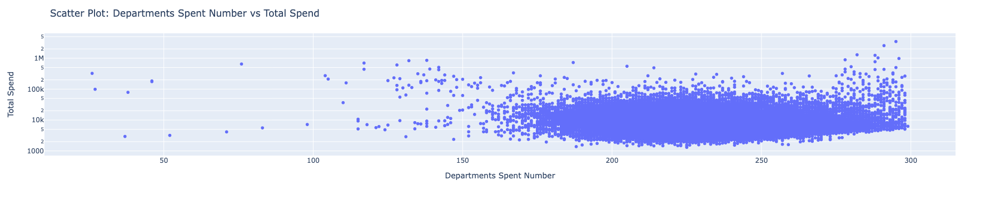

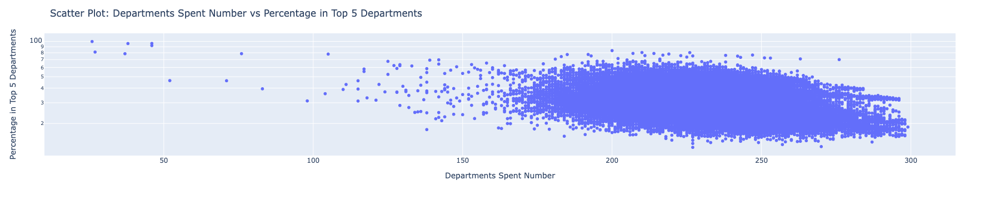

In [530]:
# Draw Scatter plots between Total Spend and Other Two Attributes
plot_scatter(df_desc, 12, [0, 11], log_x=False, log_y=True, height = 300)

I divide customers into **2 groups**  

Threshold:  
85%        `254 Departments`  

Maximum we will have 3 x 2 x 2 = 12 groups

### Step 3. Segment Customers

Now we are: **adding group labels in `df_desc`:**

for **df_desc.iloc[:, 0]**:   
      Group 1 <= 10%        
10% < Group 2 < 92%        
      Group 3 <= 92%      


for **df_desc.iloc[:, 11]**:   
       Group 1 < 75%  
75% <= Group 2  


for **df_desc.iloc[:, 12]**:  
       Group 1 < 85%  
85% <= Group 2  

In [531]:
# Create a new column 'TotalSpendGroup'
df_desc['TotalSpendGroup'] = 0

# Add thresholds
quantile10 = df_desc.iloc[:, 0].quantile(0.1)
quantile92 = df_desc.iloc[:, 0].quantile(0.92)
    
# Add Group Number based on thresholds:
for idx, row in df_desc.iterrows():
    
    value = row.iloc[0]
    
    if value <= quantile10:
        df_desc.at[idx, 'TotalSpendGroup'] = 1
        
    elif quantile10 < value < quantile92:
        df_desc.at[idx, 'TotalSpendGroup'] = 2
        
    else:
        df_desc.at[idx, 'TotalSpendGroup'] = 3
        
        
        
# Add a new column 'Top5PercentageGroup'
df_desc['Top5PercentageGroup'] = 0

# Add thresholds
quantile75 = df_desc.iloc[:, 11].quantile(0.75)
     
# Add Group Number based on thresholds:
for idx, row in df_desc.iterrows():
    
    value = row.iloc[11]
    
    if value < quantile75:
        df_desc.at[idx, 'Top5PercentageGroup'] = 1
        
    else:
        df_desc.at[idx, 'Top5PercentageGroup'] = 2

         
        
# Add a new column 'DepartmentsSpentNGroup'
df_desc['DepartmentsSpentNGroup'] = 0

# Add thresholds
quantile10 = df_desc.iloc[:, 12].quantile(0.1)
quantile85 = df_desc.iloc[:, 12].quantile(0.85)

# Add Group Number based on thresholds:
for idx, row in df_desc.iterrows():
    
    value = row.iloc[12]
    
    if value < quantile85:
        df_desc.at[idx, 'DepartmentsSpentNGroup'] = 1
        
    else:
        df_desc.at[idx, 'DepartmentsSpentNGroup'] = 2     
        

# Generate final group:
df_desc['CustomerGroup'] = 0


# Function to concatenate the group values into a unique CustomerGroup identifier
def assign_customer_group(row):
    return f"{int(row['TotalSpendGroup'])}-{int(row['Top5PercentageGroup'])}-{int(row['DepartmentsSpentNGroup'])}"


# Apply function:
df_desc['CustomerGroup'] = df_desc.apply(assign_customer_group, axis=1)


df_desc.to_csv('./DS/group_customer_data.csv')

In [532]:
df_desc.iloc[:, -4:].head(3)

,TotalSpendGroup,Top5PercentageGroup,DepartmentsSpentNGroup,CustomerGroup
CustomerID,,,,
Customer 1,2,2,1,2-2-1
Customer 2,2,1,2,2-1-2
Customer 3,2,1,2,2-1-2


In [533]:
# Count each set of customers
print(df_desc.iloc[:, -1].value_counts())

CustomerGroup
2-1-1    26872
2-2-1    10207
2-1-2     6534
1-1-1     3669
3-1-1     2551
1-2-1     1354
3-2-1     1072
2-2-2      750
3-1-2      616
1-1-2      335
3-2-2       90
1-2-2       53
Name: count, dtype: int64


## Q2. Similar Customers and Sales Opportunities
Find sets of customers with similar properties with respect to their categories and sales opportunities

### Insights From the Features and Thresholds Defined:

For `CustomerGroup`, there are 3 digits representing 3 different levels of each customer:

**1st digit:**  **TotalSpendGroup:**   
- Group 1 <= `$3481.62`  
- `$3481.62` <   Group 2 < `$19597.45`  
- Group 3 >= $19597.45` 

**2nd digit:**  **Top5PercentageGroup:**  
-  Group 1 < `35%`    
-  Group 2 >= `35%`

**3rd digit:**  **DepartmentsSpentNGroup:**  
- Group 1 < `254 Dept`  
- Group 2 >= `254 Dept`

<span style="background-color: #ADD8E6">For example, if a customer is labeld as '1-2-2', which means that customer total spend <= $3481.62, spend more than 35% of money on the 5 most spending departments, and might spend on more than 254 departments. There are 53 customers in the table are labeled as '1-2-2.'</span>

**Table of Summarization**

| Group Number | Total Spend             | Percentage Spend on Top 5 Departments | Departments Spent | Total Customers | Customer Description                                              |  Potential Sales Opportunities                           |
|--------------|-------------------------|---------------------------------------|-------------------|-----------------|-------------------------------------------------------------------|-------------------------------|
| 1-1-1        | <= 3,481.62             | < 35%                                 | < 254             | 3669            | Low spenders, less department focus and less spend                  | In general, huge potential |
| 1-1-2        | <= 3,481.62             | < 35%                                 | >= 254            | 335             | Low spenders, wide department range and less target department spend |  On several target departments (dpts)   |
| 1-2-1        | <= 3,481.62             | >= 35%                                | < 254             | 1354            | Low spenders, focus on top departments spend                       | On target dpts, also in general |
| 1-2-2        | <= 3,481.62             | >= 35%                                | >= 254            | 53              | Low spenders, wide department range but but more target department spend  | On other dpts besides target dpts|
| 2-1-1        | 3,481.63 -  19,597.44   | < 35%                                 | < 254             | 26872           | Moderate spenders, less department focus and spend                 |  In general |
| 2-1-2        | 3,481.63 -  19,597.44   | < 35%                                 | >= 254            | 6534            | Moderate spenders, wide department range and less target department spend | On target dpts, also other dpts  |
| 2-2-1        | 3,481.63 -  19,597.44   | >= 35%                                | < 254             | 10207           | Moderate spenders, focus on top departments spend                  | On target dpts and also other dpts|
| 2-2-2        | 3,481.63 -  19,597.44   | >= 35%                                | >= 254            | 750             | Moderate spenders, highly diverse interests but more spend on target department    | On other dpts besides target dpts |
| 3-1-1        | >= 19,597.45            | < 35%                                 | < 254             | 2551            | High spenders, less department focus and spend                     | On target dpts |
| 3-1-2        | >= 19,597.45            | < 35%                                 | >= 254            | 616             | High spenders, wide department range and less target department spend | On target dpts |
| 3-2-1        | >= 19,597.45            | >= 35%                                | < 254             | 1072            | High spenders, focus on top departments spend                      | On other dpts    |
| 3-2-2        | >= 19,597.45            | >= 35%                                | >= 254            | 90              | High spenders, highly diverse interests but more spend on target department | On other dpts |

### Insights From the Department Incremental Sales Data

#### Scatter Plots to Show the Medium Spend for Each Department in Each Customer Group

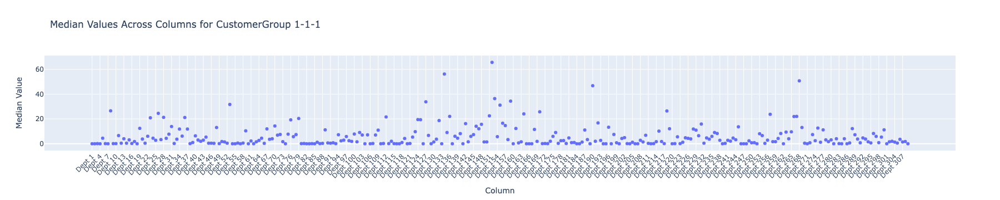

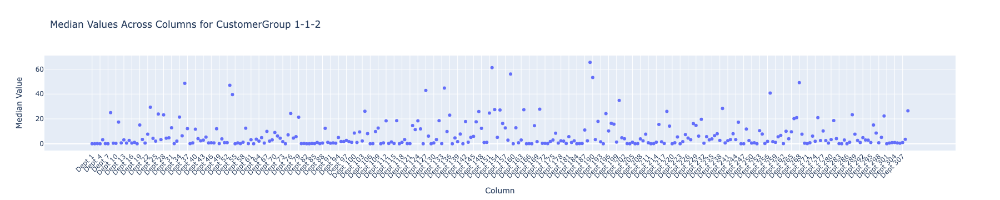

In [307]:
# Processing data
df['CustomerGroup'] = 0
df['CustomerGroup'] = df_desc['CustomerGroup']

# Comment out for scatter plots for all groups
# groups = [ '1-1-1', '1-1-2', '1-2-1', '1-2-2', '2-1-1', '2-1-2', '2-2-1', '2-2-2', '3-1-1', '3-1-2', '3-2-1', '3-2-2' ]
groups = [ '1-1-1', '1-1-2']

for group in groups:
    # Get medium
    tmp = df[df['CustomerGroup'] == group].describe().loc['50%']
    tmp = tmp.reset_index().rename(columns={'index': 'Column', 0: 'Value'})

    # Use Plotly to create a scatter plot
    fig = px.scatter(tmp, x='Column', y='50%', title=f'Median Values Across Columns for CustomerGroup {group}')

    # Customize the layout
    fig.update_layout(xaxis_title='Column', yaxis_title='Median Value', xaxis_tickangle=-45)

    # Show the plot
    fig.show()

<a id="Q2"></a>

#### TOP Departments Attribute More to Group Customers

<span style="background-color: #FFF9C4">Details please see below section [2.6.4. Best features](#best_features)</span>

Based on those important departments for grouping the customers, we might find more business insights. Besides, from the scatter plots, we can identify the departments that have higher contributes to our salling, and we can define strategies based on this.

## Q3. Customer Portrait and Potential Sales Strategy
Have an easy-to-understand way of describing a typical customer from each of the sets/groups.

Customer Group | Customer Portrait | Total Customers | Potential Sales Strategy
---------------|----------------------------|----------------|-------------------------
1-1-1 | Tend to make minimal purchases across a limited range of departments. | 3,669 | Launch targeted promotional campaigns emphasizing product value and diversity to foster wider interest and increased spending. Introduce on-site taste or other interactive sales practices.
1-1-2 | Explore many departments but spend little, indicating curiosity. | 335 | Find potential cross-departmental sales opportunities. Customize marketing strategies to highlight department-specific products; also encourage spend or target departments.
1-2-1 | Spend a significant portion of their budget on top departments. | 1,354 | Enhance focus on high-margin products within preferred departments by upselling and promoting product bundles. Highlight exclusive items and benefits to their key interest areas.
1-2-2 | Have diverse interests but spend conservatively across them. | 53 | Design personalized promotional offers based on individual spending habits and preferences. Use personal recommendations to discover more sales opportunities.
2-1-1 | Make moderate purchases without significant focus on specific areas. | 26,872 | Encourage them to repeat purchases by widespread marketing and promoting loyalty programs and exclusive benefits.
2-1-2 | Engage with a wide array of departments but focus less on any. | 6,534 | Offer deals to try and spend in new departments with multi-purchase discounts; also find potential target departments and encourage them to buy more.
2-2-1 | Focus spending on preferred departments, showing brand loyalty. | 10,207 | Provide access to exclusive products or limited editions, using sales approaches to reinforce brand loyalty and encouraging higher spend (upsalling).
2-2-2 | Display varied interests with a readiness to explore and spend more. | 750 | Increase their spend across various departments, also upsalling on their target departments.
3-1-1 | Spend heavily in a wide selection, but has potential to spend on more departments. | 2,551 |  Implement personalized marketing campaigns to showcase the depth and variety of available product ranges.
3-1-2 | High spending across broad departments. | 616 | Create unique customer experiences with early access to new releases and exclusive events, catering to their pursuit of novelty and enhancing customer loyalty.
3-2-1 | Spend heavily within a narrow selection. | 1,072 | Develop exclusive product lines and offer superior customer service to underscore their premium status.
3-2-2 | Diverse interests with significant spending, also focusing on spending more on target departments. | 90 | Refine the approach to emphasize personalized service and exclusive offerings in both their preferred and less frequented departments.

<span style="background-color: #FFF9C4">**Note: These catagories are by far the best knowledge, looking forward to contributing more business insight if I am given more context about the deptartments.**</span>


## Using ML Models to Predict Customer Groups Based on Spend of Each Department:

<span style="background-color: #FFF9C4">We can also directly use a xgboost model (best model with accuracy 88.36%) to predict customer groups given any new data with those 309 department incremental sales. The process of getting the best model is in this section.</span>

*Note: The model is stored in `"./DS/model.pkl"`*

### Preparing Data and Evaluation Function

In [301]:
# Import packages
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, balanced_accuracy_score, log_loss
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier

import optuna

import warnings
warnings.filterwarnings("ignore")

In [281]:
# Prepare data
df['CustomerGroup'] = 0
df['CustomerGroup'] = df_desc['CustomerGroup']

# Function to calculate metrics
def calculate_metrics(y_true, y_pred, y_prob=None, model_name='Model'):
    metrics = {
        'Accuracy': accuracy_score(y_true, y_pred),
        'Precision Macro': precision_score(y_true, y_pred, average='macro'),
        'Precision Micro': precision_score(y_true, y_pred, average='micro'),
        'Recall Macro': recall_score(y_true, y_pred, average='macro'),
        'Recall Micro': recall_score(y_true, y_pred, average='micro'),
        'F1 Macro': f1_score(y_true, y_pred, average='macro'),
        'F1 Micro': f1_score(y_true, y_pred, average='micro'),
        'Balanced Accuracy': balanced_accuracy_score(y_true, y_pred)
    }
    if y_prob is not None:
        lb = LabelBinarizer()
        lb.fit(y_true)
        y_true_binarized = lb.transform(y_true)
        metrics['Log Loss'] = log_loss(y_true_binarized, y_prob)
    return metrics

In [308]:
# Separate features and target variable
X = df.drop("CustomerGroup", axis=1)
y = df["CustomerGroup"]

# Encode the target variable
encoder = LabelEncoder()
y = encoder.fit_transform(y)
target_mapping = {index: label for index, label in enumerate(encoder.classes_)}
print(target_mapping)

{0: '1-1-1', 1: '1-1-2', 2: '1-2-1', 3: '1-2-2', 4: '2-1-1', 5: '2-1-2', 6: '2-2-1', 7: '2-2-2', 8: '3-1-1', 9: '3-1-2', 10: '3-2-1', 11: '3-2-2'}


### Model Selection

Based on the below model evaluation, XGBoost is the best model (baseline). 


| Model             | Accuracy | Precision Macro | Precision Micro | Recall Macro | Recall Micro | F1 Macro | F1 Micro | Balanced Accuracy | Log Loss  |
|-------------------|----------|-----------------|-----------------|--------------|--------------|----------|----------|-------------------|-----------|
| Decision Tree     | 0.638481 | 0.398811        | 0.638481        | 0.409304     | 0.638481     | 0.403137 | 0.638481 | 0.409304          | 13.030475 |
| Random Forest     | 0.752611 | 0.666595        | 0.752611        | 0.458514     | 0.752611     | 0.511891 | 0.752611 | 0.458514          | 0.784714  |
| Gradient Boosting | 0.808336 | 0.606166        | 0.808336        | 0.515935     | 0.808336     | 0.547631 | 0.808336 | 0.515935          | 0.567722  |
| SVM               | 0.729877 | 0.512420        | 0.729877        | 0.363235     | 0.729877     | 0.362241 | 0.729877 | 0.363235          | NaN       |
| XGBoost           | 0.850291 | 0.691397        | 0.850291        | 0.556229     | 0.850291     | 0.600551 | 0.850291 | 0.556229          | 0.395982  |

    

In [282]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=1)

# Initialize the models with default parameters (baseline)
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=1),
    "Random Forest": RandomForestClassifier(random_state=1),
    "Gradient Boosting": GradientBoostingClassifier(random_state=1),
    "SVM": SVC(random_state=1),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=1)
}

results = {}

# Train, predict, and evaluate each model
for name, model in models.items():
    # Fit model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    # Predict probabilities if model supports it
    if hasattr(model, "predict_proba"):
        y_prob = model.predict_proba(X_test)
        metrics = calculate_metrics(y_test, y_pred, y_prob, name)
    else:
        metrics = calculate_metrics(y_test, y_pred, model_name=name)
    
    # Store results
    results[name] = metrics

# Display the results
pd.DataFrame(results).T 

/Users/jingbinc/anaconda3/envs/jetro_test/lib/python3.9/site-packages/sklearn/metrics/_classification.py:2916: UserWarning:

The y_pred values do not sum to one. Starting from 1.5 thiswill result in an error.

/Users/jingbinc/anaconda3/envs/jetro_test/lib/python3.9/site-packages/sklearn/metrics/_classification.py:2916: UserWarning:

The y_pred values do not sum to one. Starting from 1.5 thiswill result in an error.

/Users/jingbinc/anaconda3/envs/jetro_test/lib/python3.9/site-packages/sklearn/metrics/_classification.py:2916: UserWarning:

The y_pred values do not sum to one. Starting from 1.5 thiswill result in an error.

/Users/jingbinc/anaconda3/envs/jetro_test/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/jingbinc/anaconda3/envs/jetro_test/lib/python3.9/site-packages/sklearn/metrics/_classif

,Accuracy,Precision Macro,Precision Micro,Recall Macro,Recall Micro,F1 Macro,F1 Micro,Balanced Accuracy,Log Loss
Decision Tree,0.638481,0.398811,0.638481,0.409304,0.638481,0.403137,0.638481,0.409304,13.030475
Random Forest,0.752611,0.666595,0.752611,0.458514,0.752611,0.511891,0.752611,0.458514,0.784714
Gradient Boosting,0.808336,0.606166,0.808336,0.515935,0.808336,0.547631,0.808336,0.515935,0.567722
SVM,0.729877,0.512420,0.729877,0.363235,0.729877,0.362241,0.729877,0.363235,NaN
XGBoost,0.850291,0.691397,0.850291,0.556229,0.850291,0.600551,0.850291,0.556229,0.395982


### Hyperparameter Tuning

In [290]:
def tune_model(trial):
    
    # param pool
    hyperparams = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 9),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-4, 1e-1),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-5, 1),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-5, 1),
    }
    
    # Model initialization and training
    model = XGBClassifier(**hyperparams, use_label_encoder=False, eval_metric='logloss', random_state=1)
    model.fit(X_train, y_train)
    
    # Predictions and evaluation
    preds = model.predict(X_test)
    accuracy = accuracy_score(y_test, preds)
    
    return accuracy

study = optuna.create_study(direction='maximize')
study.optimize(tune_model, n_trials=30)  # 30 trials for baysian optimization

# Best hyperparameters
print("Best hyperparameters:", study.best_trial.params)

[I 2024-03-28 18:39:13,852] A new study created in memory with name: no-name-96449377-8372-42f6-adf5-1c40c1707903
[I 2024-03-28 18:39:47,224] Trial 0 finished with value: 0.8339340171887996 and parameters: {'n_estimators': 294, 'max_depth': 3, 'learning_rate': 0.0789452003116346, 'subsample': 0.8052843156655092, 'colsample_bytree': 0.5898071828579483, 'min_child_weight': 2, 'reg_alpha': 0.017353383979734214, 'reg_lambda': 0.03151417626021585}. Best is trial 0 with value: 0.8339340171887996.
[I 2024-03-28 18:41:02,281] Trial 1 finished with value: 0.7415211163478421 and parameters: {'n_estimators': 424, 'max_depth': 4, 'learning_rate': 0.007679619860813213, 'subsample': 0.8054070345982922, 'colsample_bytree': 0.9628577665356612, 'min_child_weight': 1, 'reg_alpha': 0.025868625414509735, 'reg_lambda': 0.19781694982172845}. Best is trial 0 with value: 0.8339340171887996.
[I 2024-03-28 18:42:41,806] Trial 2 finished with value: 0.8260789206173181 and parameters: {'n_estimators': 449, 'max_d

Best hyperparameters: {'n_estimators': 627, 'max_depth': 5, 'learning_rate': 0.09967425192352386, 'subsample': 0.6716864905895105, 'colsample_bytree': 0.8031585788355905, 'min_child_weight': 9, 'reg_alpha': 0.001543726372090482, 'reg_lambda': 0.24983857722391387}


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8031585788355905, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09967425192352386,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=9, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=627, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [291]:
# Retrain final model using the best hyperparameters and full data

best_hyperparams = study.best_trial.params

final_model = XGBClassifier(**best_hyperparams, use_label_encoder=False, eval_metric='logloss', random_state=1)

final_model.fit(X, y) # Using full data to train the best model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8031585788355905, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric='logloss', feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09967425192352386,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=9, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=627, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

<a id="best_features"></a>
### Best Features

([Go back to Q2](#Q2))

In [304]:
# Best features

feature_importances = final_model.feature_importances_

# df to hold feature and importance
feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

In [303]:
print(feature_importance_df.head(40))

      Feature  Importance
140  Dept 141    0.084627
125  Dept 126    0.067058
300  Dept 301    0.031815
82    Dept 83    0.020258
6      Dept 7    0.019275
80    Dept 81    0.018918
203  Dept 204    0.018791
84    Dept 85    0.018775
269  Dept 270    0.017828
231  Dept 232    0.017314
8      Dept 9    0.016624
128  Dept 129    0.015814
85    Dept 86    0.010676
215  Dept 216    0.009267
114  Dept 115    0.008454
54    Dept 55    0.008440
118  Dept 119    0.008045
65    Dept 66    0.007409
31    Dept 32    0.007107
100  Dept 101    0.006788
106  Dept 107    0.006311
283  Dept 284    0.006176
254  Dept 255    0.006039
164  Dept 165    0.006031
11    Dept 12    0.005782
212  Dept 213    0.005684
188  Dept 189    0.005613
305  Dept 306    0.005496
116  Dept 117    0.005269
76    Dept 77    0.005214
205  Dept 206    0.005151
173  Dept 174    0.005095
37    Dept 38    0.005062
255  Dept 256    0.004969
278  Dept 279    0.004728
119  Dept 120    0.004684
247  Dept 248    0.004594
165  Dept 16

In [550]:
# Save model to local
import pickle

model_address = './DS/model.pkl'

with open(model_address, 'wb') as file:
    pickle.dump(final_model, file)

## Usecase: Tool for Tracking Similar Customers

In this usecase, I developed a function (based on Annoy Tree) to quickly getting the top N similar customers by any target customers using 309 incremental sales data. User can input `CUSTOMER_ID` (integer), `TOP_N` (top N similar custoers want to get), `DF` (309 incremental sales data, and `DF_DESC` (any descriptive table for those customers in `DF`) and get the result in a short amount of time. 

We can also build UI for this for better supporting the business.

In [543]:
# Input data
DF = pd.read_csv("./DS/clean_customer_data.csv", index_col=0)
DF_DESC = pd.read_csv('./DS/group_customer_data.csv', index_col=0)
DF_DESC = DF_DESC.iloc[:, [0, 11, 12, -1]] # Choose the important columns

In [544]:
# Annoy Tree (For calculating efficiency)

from annoy import AnnoyIndex
import pandas as pd

# Number of departments
num_dimensions = DF.shape[1]

# Initialize Annoy index
t = AnnoyIndex(num_dimensions, 'angular') # Using angular since order of the feature is not important


# Adding items (customers) to the index
for i in range(len(DF)):
    
    # Select values
    item_values = DF.iloc[i].values
    t.add_item(i, item_values)

t.build(8) # build 8 trees


def find_similar_customers_annoy_tree(customer_id, df, df_desc, top_n=200):
    """
    Find and return the top_n most similar customers to a given customer ID along with their distances, including descriptive information from df_desc.
    
    Args:
    - customer_id: ID of the customer, starting from 1.
    - df: DataFrame containing customer and department clean data.
    - df_desc: DataFrame containing descriptive information for customers, indexed similarly to df.
    - top_n: Number of top similar customers to return. Default is 200.
    
    Returns:
    - A DataFrame containing the top_n most similar customers, their distances from the target customer, all their columns (attributes) from df,
      descriptive information from df_desc, with 'CustomerID' renamed to 'Similar Customers' and 'Distance' as the second column.
    """
    customer_index = customer_id - 1
    
    if customer_index >= len(df) or customer_index < 0:
        return "Customer ID is out of range."
    
    # Get the annoy index
    similar_indices, distances = t.get_nns_by_item(customer_index, top_n + 1, include_distances=True)
    
    similar_customers = df.iloc[similar_indices].copy()
    similar_customers['Distance'] = distances
    similar_customers['SimilarCustomers'] = df.index[similar_indices]
    
    # Join df_desc on index
    similar_customers = similar_customers.join(df_desc, how='left', rsuffix='_desc')
    
    # Reorder columns
    first_cols = ['SimilarCustomers', 'Distance']
    other_cols = [col for col in similar_customers.columns if col not in first_cols]
    similar_customers = similar_customers[first_cols + other_cols]
    
    return similar_customers.reset_index(drop=True)

### Use the Tool

In [547]:
# INPUT Parameters

CUSTOMER_ID = 111 # Customer ID
TOP_N = 4 # Top Similar Customers
DF = DF
DF_DESC = DF_DESC

In [548]:
# Here are the top similar customers based on annoy tree
find_similar_customers_annoy_tree(CUSTOMER_ID, DF, DF_DESC, TOP_N)

,SimilarCustomers,Distance,Dept 1,Dept 2,Dept 3,Dept 4,Dept 5,Dept 6,Dept 7,Dept 8,...,Dept 304,Dept 305,Dept 306,Dept 307,Dept 308,Dept 309,Total Spend,Percentage in Top 5 Departments,Departments Spent Number,CustomerGroup
0,Customer 111,0.000000,0.00,0.0,15.66,0.45,0.00,0.25,0.71,38.47,...,1.00,0.00,0.37,1.16,31.29,64.80,5804.15,25.996916,198,2-1-1
1,Customer 47582,0.588402,0.03,0.0,13.27,0.71,5.37,0.09,0.51,84.78,...,1.59,0.00,1.10,1.67,0.00,99.84,7519.32,24.956113,217,2-1-1
2,Customer 1589,0.645518,0.03,0.0,11.50,0.62,4.66,0.08,0.44,0.00,...,1.38,6.09,0.95,1.44,0.00,77.85,6446.63,27.355068,217,2-1-1
3,Customer 6046,0.660845,0.01,0.0,0.00,0.14,4.93,0.05,0.50,0.00,...,0.90,3.08,3.19,0.96,17.54,47.50,5180.30,28.313997,225,2-1-1
4,Customer 40988,0.681383,0.07,0.0,0.13,0.01,7.98,0.16,0.00,57.27,...,0.79,0.32,2.36,2.53,4.17,53.88,4432.63,24.561265,268,2-1-2
